In [1]:
'''
Importing the Libraries and Frameworks 
'''
import argparse
import pickle
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50,preprocess_input
import numpy as np
from colored import fg
import random

In [6]:
'''
Loading all the dependencis file 
'''
with open('./utilities/engine_modal.pickle','rb') as f:
    neighbours = pickle.load(f)
with open('./utilities/filenames-coco2014.pickle','rb') as f:
    fileNames = pickle.load(f)
with open('./utilities\image_to_caption.pickle','rb') as f:
    image_path_to_caption = pickle.load(f)
with open('./utilities/features-coco2014-resnet.pickle','rb') as f:
    features_list = pickle.load(f)

In [8]:
from sklearn.manifold import TSNE
import time

In [19]:
selected_features = features_list[:4000]
# selected_class_ids = class_ids[:4000]
selected_filenames = fileNames[:4000]

time_start = time.time()
tsne_results = TSNE(n_components=2, verbose=1,
                    metric='euclidean').fit_transform(selected_features)
print('t-SNE done! Time elapsed: {} seconds'.format(time.time() - time_start))

In [14]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [13]:
tsne_results.shape

(4000, 2)

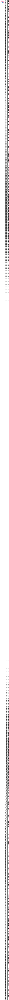

In [21]:
tsne_result_df = pd.DataFrame({'tsne_1': tsne_results[:,0], 'tsne_2': tsne_results[:,1],'label':selected_filenames})
fig, ax = plt.subplots(1)
sns.scatterplot(x='tsne_1', y='tsne_2', hue='label', data=tsne_result_df, ax=ax,s=120,)
lim = (tsne_results.min()-5, tsne_results.max()+5)
ax.set_xlim(lim)
ax.set_ylim(lim)
ax.set_aspect('equal')
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)